In [2]:
import aug_util as aug
import wv_util as wv
import matplotlib.pyplot as plt
import numpy as np
import csv
%matplotlib inline
import os

In [13]:
chip_dir = "/Users/eddiebedada/datasets/xview/"

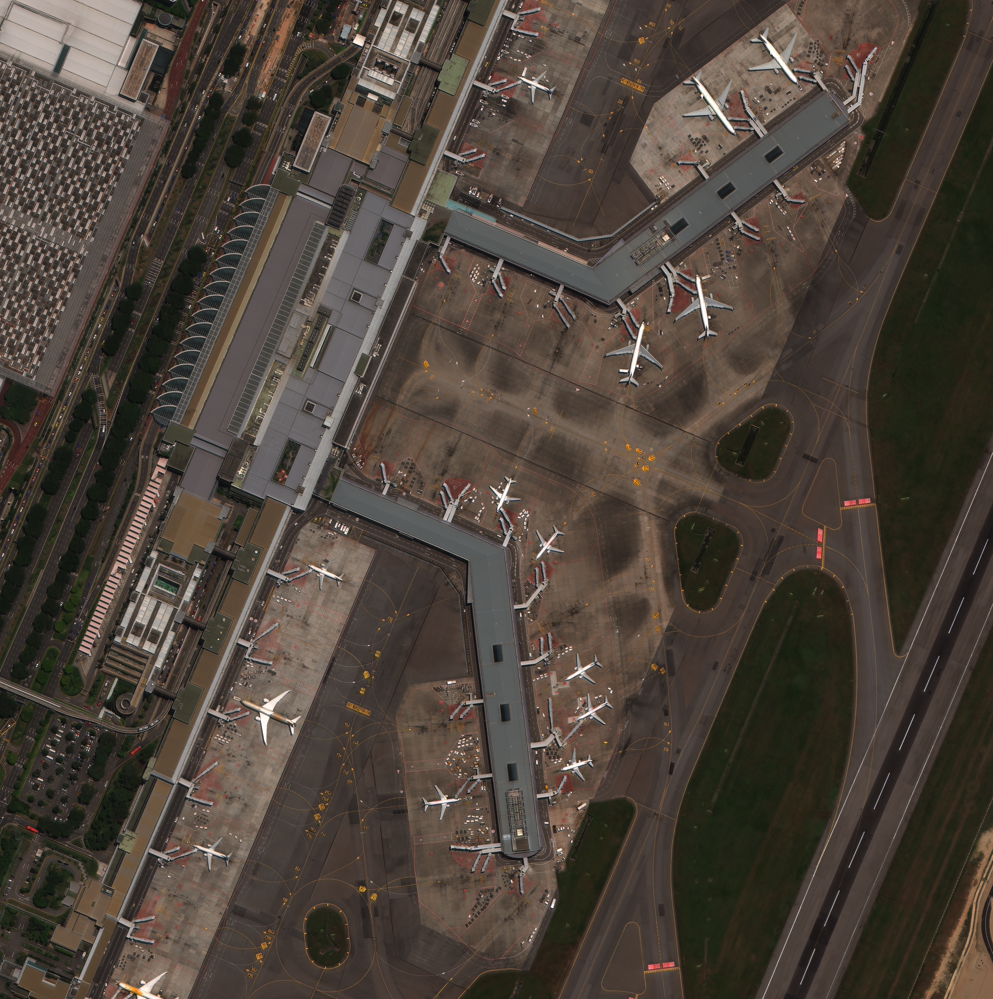

In [556]:
#Load an image
chip_name = os.path.join(chip_dir,'planes/1076.tif')
#arr = wv.get_image(chip_name)
Image.open(chip_name)

In [557]:
chip_name.split('/')[-1]

'1076.tif'

In [558]:
#Loading our labels
coords, chips, classes = wv.get_labels(os.path.join(chip_dir,'xView_train.geojson'))
#We only want to coordinates and classes that are within our chip
chip_name = chip_name.split('/')[-1]
coords = coords[chips==chip_name]
classes = classes[chips==chip_name].astype(np.int64)

100%|██████████| 601937/601937 [00:02<00:00, 237538.37it/s]


In [559]:
(classes)

array([73, 18, 73, 18, 73, 73, 19, 18, 18, 73, 73, 18, 73, 18, 19, 18, 18,
       19, 18, 18, 19, 19, 19, 19, 18, 19, 19, 18, 18, 18, 18, 18, 18, 18,
       18, 18, 18, 18, 18, 18, 18, 18, 18, 18, 18, 18, 18, 18, 18, 18, 18,
       18, 18, 18, 18, 18, 23, 23, 18, 18, 18, 18, 18, 18, 18, 18, 18, 18,
       18, 18, 18, 18, 18, 18, 23, 18, 18, 18, 18, 18, 18, 18, 19, 18, 18,
       18, 18, 18, 73, 18, 18, 18, 18, 18, 18, 18, 18, 18, 18, 18, 18, 18,
       18, 18, 18, 18, 18, 18, 18, 18, 18, 18, 18, 18, 18, 18, 18, 18, 18,
       18, 18, 18, 18, 18, 18, 18, 18, 18, 18, 18, 18, 18, 18, 18, 18, 18,
       18, 18, 18, 18, 18, 18, 18, 18, 18, 23, 18, 18, 19, 19, 19, 19, 19,
       19, 13, 73, 13, 18, 18, 23, 18, 18, 18, 18, 18, 18, 18, 18, 18, 18,
       18, 18, 73, 19, 18, 19, 18, 23, 18, 18, 18, 18, 18, 18, 18, 18, 18,
       18, 18, 18, 19, 18, 18, 18, 18, 18, 18, 18, 18, 18, 18, 18, 18, 18,
       18, 18, 18, 18, 18, 18, 18, 18, 19, 19, 18, 18, 18, 18, 18, 18, 19,
       18, 18, 18, 18, 18

In [560]:
np.unique(classes)

array([13, 18, 19, 20, 21, 23, 34, 38, 53, 73])

In [561]:
#np.unique(classes[3])
#chips

array(['2355.tif', '2355.tif', '2355.tif', ..., '389.tif', '389.tif',
       '389.tif'], dtype=object)

In [36]:
#Load the class number -> class string label map
labels = {}
with open('xview_class_labels.txt') as f:
    for row in csv.reader(f):
        labels[int(row[0].split(":")[0])] = row[0].split(":")[1]

In [518]:
# import geojson
# with open(os.path.join(chip_dir,'xView_train.geojson')) as f:
#     gj = geojson.load(f)

In [519]:
# import json
# with open(os.path.join(chip_dir,'xView_train.geojson')) as f:
#         data = json.load(f)

# coords = np.zeros((len(data['features']),4))
# chips = np.zeros((len(data['features'])),dtype="object")
# classes = np.zeros((len(data['features'])))

In [302]:
#print([labels[i] for i in (classes)])
# for i in range(c_img.shape[0]):
#     print(labels[i])
# for i in classes:
#     #labels[i]=='Bus'
#     print(labels[i])
#     #print(labels[])
    #print(bus)

In [566]:
labels

{11: 'Fixed-wing Aircraft',
 12: 'Small Aircraft',
 13: 'Cargo Plane',
 15: 'Helicopter',
 17: 'Passenger Vehicle',
 18: 'Small Car',
 19: 'Bus',
 20: 'Pickup Truck',
 21: 'Utility Truck',
 23: 'Truck',
 24: 'Cargo Truck',
 25: 'Truck w/Box',
 26: 'Truck Tractor',
 27: 'Trailer',
 28: 'Truck w/Flatbed',
 29: 'Truck w/Liquid',
 32: 'Crane Truck',
 33: 'Railway Vehicle',
 34: 'Passenger Car',
 35: 'Cargo Car',
 36: 'Flat Car',
 37: 'Tank car',
 38: 'Locomotive',
 40: 'Maritime Vessel',
 41: 'Motorboat',
 42: 'Sailboat',
 44: 'Tugboat',
 45: 'Barge',
 47: 'Fishing Vessel',
 49: 'Ferry',
 50: 'Yacht',
 51: 'Container Ship',
 52: 'Oil Tanker',
 53: 'Engineering Vehicle',
 54: 'Tower crane',
 55: 'Container Crane',
 56: 'Reach Stacker',
 57: 'Straddle Carrier',
 59: 'Mobile Crane',
 60: 'Dump Truck',
 61: 'Haul Truck',
 62: 'Scraper/Tractor',
 63: 'Front loader/Bulldozer',
 64: 'Excavator',
 65: 'Cement Mixer',
 66: 'Ground Grader',
 71: 'Hut/Tent',
 72: 'Shed',
 73: 'Building',
 74: 'Aircra

In [563]:

#We can find which classes are present in this image
print([labels[i] for i in np.unique(classes)])

['Cargo Plane', 'Small Car', 'Bus', 'Pickup Truck', 'Utility Truck', 'Truck', 'Passenger Car', 'Locomotive', 'Engineering Vehicle', 'Building']


In [568]:
#We can chip the image into 500x500 chips
c_img, c_box, c_cls = wv.chip_image(img = arr, coords= coords, classes=classes, shape=(500,500))
print("Num Chips: %d" % c_img.shape[0])

Num Chips: 36


In [636]:
#c_box

In [373]:
####################from the stacked images
# select images whose label/class
#matches the bus_class
# bus_cls = []
# each_imgs_cls = []
# for i in range(c_img.shape[0]):
#     cls = c_cls[i]
#     #print(i,cls)
#     #each_imgs_cls[i] = c_cls[i]
#     each_imgs_cls.append(c_cls[i])

# for cls in each_imgs_cls:
#     for value in cls:
#         if value ==13:
#             bus_cls.append(cls)
#bus_cls
#######################

In [572]:
########## DONT DELETE #######
# dma = []
# for cls in c_cls:
#     for value in c_cls[cls]:
#         if value ==13:
#             dma.append(c_cls[cls])
# dma
################
dma2 = {}
for cls in c_cls:
    for value in c_cls[cls]:
        if value ==13:
            dma2[cls]=c_cls[cls]
dma2

{9: array([18, 18, 18, 18, 18, 18, 18, 18, 18, 18, 18, 18, 18, 18, 18, 18, 18,
        18, 18, 23, 13, 23, 23, 73, 18, 18]),
 11: array([13, 18, 18]),
 15: array([18, 18, 19, 19, 19, 19, 19, 19, 13, 18, 18, 73, 20]),
 17: array([13, 73]),
 18: array([19, 18, 13, 23, 18, 23, 23, 23, 18, 23, 53]),
 20: array([13, 19, 73]),
 21: array([19, 19, 13, 13]),
 22: array([19, 18, 19, 19, 18, 19, 13, 13, 23, 23, 13]),
 23: array([19, 23, 19, 18, 18, 13, 19, 73]),
 24: array([73, 13, 13]),
 25: array([18, 18, 21, 13, 18, 19, 23, 23]),
 26: array([13, 18, 13, 23, 23]),
 30: array([13, 18, 73, 18, 73])}

'/Users/eddiebedada/datasets/xview/output/30.png'

In [689]:
filename_base, file_extension = os.path.splitext(chip_dir+'output/')
file_extension = '.png'
filename_base


'/Users/eddiebedada/datasets/xview/output/'

In [690]:
from PIL import Image
select_img = []

for i,j in enumerate(c_img):
    for f in dma2:
        if f==i:
            expand_img = np.expand_dims(j, axis=0)
            select_img.append(expand_img)
            output_filename_n = "{}{}{}".format(filename_base, i, file_extension)

            save_image = Image.fromarray(j)
            #scaled = save_image.resize((500,256), Image.ANTIALIAS)
            save_image.save(output_filename_n, "JPEG")
            


In [601]:
from PIL import Image
select_img = {}

for i,j in enumerate(c_img):
    for f in dma2:
        if f==i:
            expand_img = np.expand_dims(j, axis=0)
            select_img[i]=expand_img
            #output_filename_n = "{}_{}{}".format(filename_base, i, file_extension)

            #save_image = Image.fromarray(j)
            #scaled = save_image.resize((500,256), Image.ANTIALIAS)
            #save_image.save(output_filename_n, "JPEG")
    

In [634]:
krr = []
for i in select_img:
    krr.append(select_img[i])

conc_selected_img_2 = np.concatenate(krr)
conc_selected_img_2.shape

(13, 500, 500, 3)

In [575]:
conc_selected_img = np.concatenate(select_img)
conc_selected_img.shape

(13, 500, 500, 3)

In [635]:
# for i, j in enumerate(conc_selected_img):
#     print(i)

In [637]:
select_box = {}
for i in dma2:
    for j in c_box:
        if j ==i:
             select_box[j]= c_box[j]

In [649]:
import random
ind = random.choice(list(select_box))
ind
#select_box.keys()
#ind = np.random.choice(select_box.keys())

9

In [654]:
select_box[ind]

array([[151., 445., 162., 461.],
       [134., 383., 145., 398.],
       [126., 400., 138., 416.],
       [118., 420., 130., 434.],
       [140., 366., 152., 381.],
       [154., 332., 166., 347.],
       [147., 349., 160., 366.],
       [168., 297., 181., 313.],
       [161., 315., 174., 331.],
       [192., 293., 202., 307.],
       [187., 308., 199., 322.],
       [179., 327., 192., 341.],
       [172., 344., 183., 356.],
       [164., 361., 175., 375.],
       [156., 379., 167., 393.],
       [141., 412., 154., 428.],
       [132., 429., 146., 445.],
       [126., 446., 138., 461.],
       [119., 462., 133., 476.],
       [338., 432., 353., 450.],
       [481., 290., 500., 401.],
       [396., 254., 412., 272.],
       [229., 252., 247., 275.],
       [  0.,  99., 434., 500.],
       [438., 148., 453., 158.],
       [147., 397., 159., 412.]])

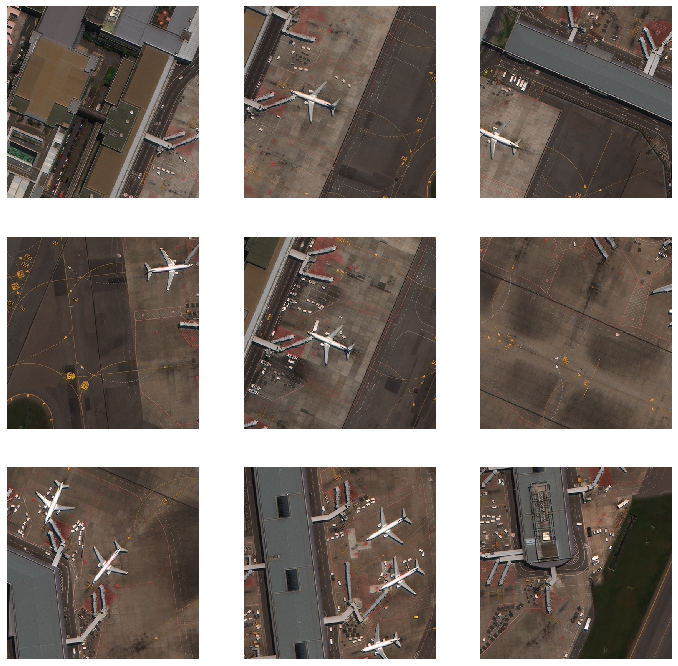

In [656]:
fig,ax = plt.subplots()
fig.set_figheight(12)
fig.set_figwidth(12)

for k in range(9):
    plt.subplot(3,3,k+1)
    plt.axis('off')
    #labelled = aug.draw_bboxes()
    plt.imshow(conc_selected_img[k])

plt.show()

In [672]:
# for i in c_cls[ind]:
#     print(labels[i])
[labels[i] for i in c_cls[ind]]

<generator object <genexpr> at 0x1d6e19c750>

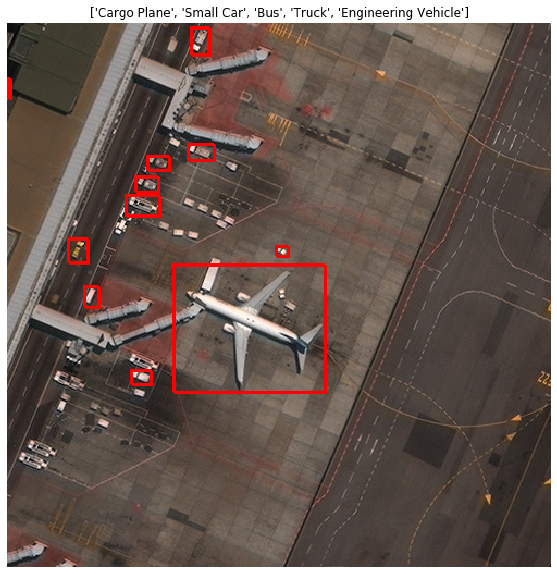

In [676]:
ind = random.choice(list(select_box))
labelled = aug.draw_bboxes(c_img[ind],c_box[ind])

plt.figure(figsize=(10,10))
plt.axis('off')
plt.title([labels[i] for i in np.unique(c_cls[ind])])
plt.imshow(labelled)
plt.show()

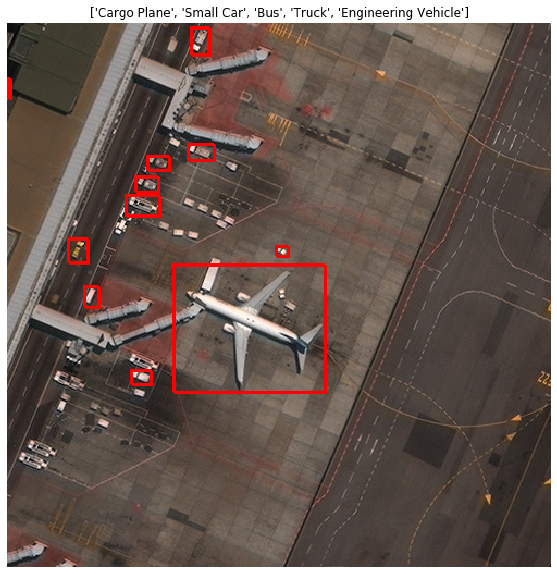

In [677]:
#We can visualize the chips with their labels
#ind = np.random.choice(range(c_img.shape[0]))
labelled = aug.draw_bboxes(c_img[ind],c_box[ind])
plt.figure(figsize=(10,10))
plt.axis('off')
plt.title([labels[i] for i in np.unique(c_cls[ind])])
plt.imshow(labelled)
plt.show()

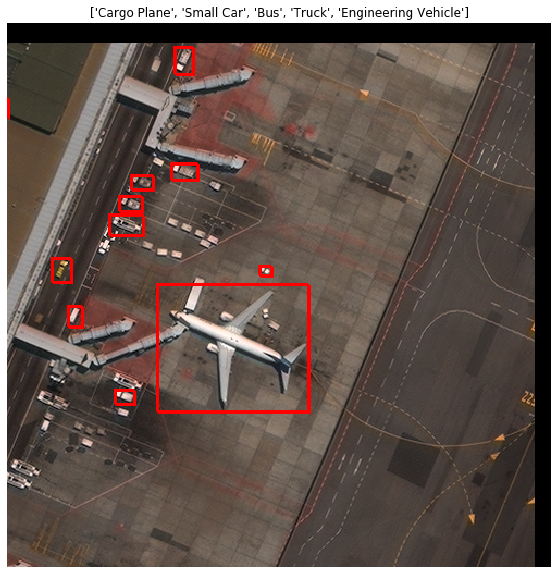

In [679]:
#We can shift the chips
i1,b1 = aug.shift_image(c_img[ind],c_box[ind])
a1 = aug.draw_bboxes(i1,b1)
plt.figure(figsize=(10,10))
plt.axis('off')
plt.title([labels[i] for i in np.unique(c_cls[ind])])
plt.imshow(a1)
plt.show()

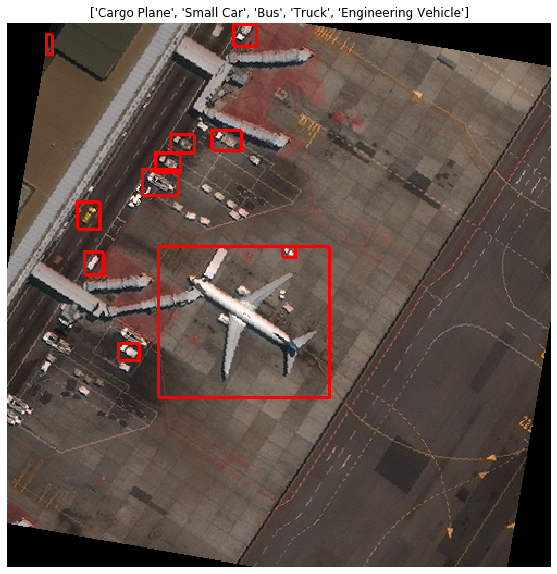

In [680]:
#We can rotate the chips
center = (int(c_img[ind].shape[0]/2),int(c_img[ind].shape[1]/2))
i2,b2 = aug.rotate_image_and_boxes(c_img[ind],10, center, c_box[ind])
a2 = aug.draw_bboxes(i2,b2)
plt.figure(figsize=(10,10))
plt.title([labels[i] for i in np.unique(c_cls[ind])])
plt.axis('off')
plt.imshow(a2)
plt.show()

In [11]:
#There are other augmentations available in 'aug_util.py'
#From here, you can save out the chipped images to a TFRecord or other medium
#Use 'process_wv.py' to create a TFRecord file from xView imagery

In [700]:
import rasterio as rio
dataset  = rio.open(os.path.join(chip_dir,'planes/1076.tif'))

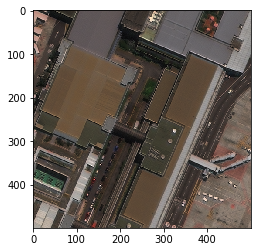

In [992]:
Z= conc_selected_img[0]
plt.imshow(Z)

In [993]:
Z.shape

(500, 500, 3)

In [994]:
#Zr = Z.reshape(Z.shape[2], Z.shape[1],Z.shape[0])
# r = Zr[0]
# g = Zr[1]
# b = Zr[2]

transform = dataset.transform
b.shape, transform

((500, 500), Affine(2.814721223571506e-06, 0.0, 103.98637943079552,
        0.0, -2.814721223571506e-06, 1.358100668104314))

In [995]:
r = Z[:,:,0]
g = Z[:,:,1]
b = Z[:,:,2]

r.shape

(500, 500)

In [996]:
with rio.open(
        os.path.join(chip_dir,'output/temp1.tif'), 'w',
        driver='GTiff', 
        height=Z.shape[0], 
        width=Z.shape[1], 
        count=3,
        dtype=r.dtype, 
        crs='+proj=latlong', transform=transform) as dst:
    for k, Z in [(1, r), (2, g), (3, b)]:
        dst.write(Z, indexes=k)
#new_dataset.write(Z,1)

In [997]:
# new_dataset =rio.open(
#     os.path.join(chip_dir,'output/temp.tif'),
#     'w',
#     driver='GTiff',
#     height=Z.shape[2],
#     width=Z.shape[1],
#     count=Z.shape[0],
#     dtype=Z.dtype,
#     crs='+proj=latlong',
#     transform=transform)